In [14]:
import csv
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from google.colab import drive 
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [16]:
import io
data= files.upload()



Saving diabetes_012_health_indicators_BRFSS2015.csv to diabetes_012_health_indicators_BRFSS2015 (3).csv


{'diabetes_012_health_indicators_BRFSS2015.csv': b'Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income\n0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0\n0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0\n0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0\n0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0\n0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,2.0,0.0,1.0,10.0,6.0,8.0\n0.0,1.0,0.0,1.0,30.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,14.0,0.0,0.0,9.0,6.0,7.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,11.0,4.0,4.0\n2.0,1.0,1

In [17]:
df=pd.read_csv('diabetes_012_health_indicators_BRFSS2015.csv')
df2=df.copy
pd.set_option('display.max_columns', None)
print(df)

        Diabetes_012  HighBP  HighChol  CholCheck   BMI  Smoker  Stroke  \
0                0.0     1.0       1.0        1.0  40.0     1.0     0.0   
1                0.0     0.0       0.0        0.0  25.0     1.0     0.0   
2                0.0     1.0       1.0        1.0  28.0     0.0     0.0   
3                0.0     1.0       0.0        1.0  27.0     0.0     0.0   
4                0.0     1.0       1.0        1.0  24.0     0.0     0.0   
...              ...     ...       ...        ...   ...     ...     ...   
253675           0.0     1.0       1.0        1.0  45.0     0.0     0.0   
253676           2.0     1.0       1.0        1.0  18.0     0.0     0.0   
253677           0.0     0.0       0.0        1.0  28.0     0.0     0.0   
253678           0.0     1.0       0.0        1.0  23.0     0.0     0.0   
253679           2.0     1.0       1.0        1.0  25.0     0.0     0.0   

        HeartDiseaseorAttack  PhysActivity  Fruits  Veggies  \
0                        0.0        

AxesSubplot(0.125,0.125;0.775x0.755)
AxesSubplot(0.125,0.125;0.775x0.755)


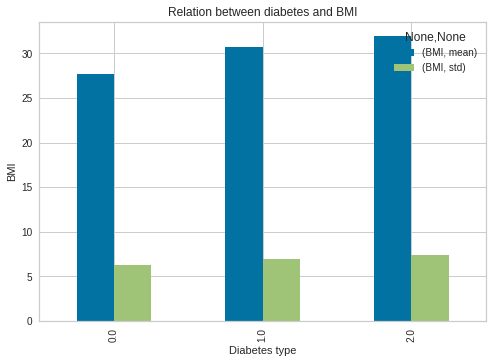

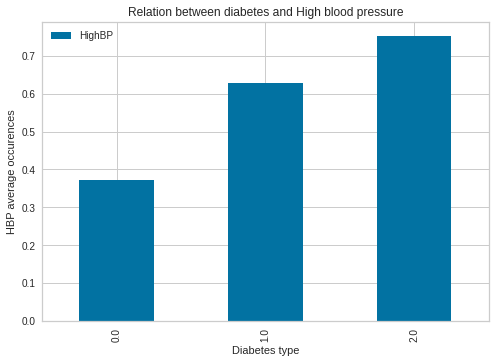

In [18]:

grouped_BMI=df.groupby('Diabetes_012')[['BMI']]
agg_BMI=grouped_BMI.agg(['mean', 'std'])
print(agg_BMI.plot(kind='bar', title='Relation between diabetes and BMI', ylabel='BMI',
         xlabel='Diabetes type'))
grouped_HBP=df.groupby("Diabetes_012")[["HighBP"]].mean()
print(grouped_HBP.plot(kind='bar', title='Relation between diabetes and High blood pressure', ylabel='HBP average occurences',
         xlabel='Diabetes type'))


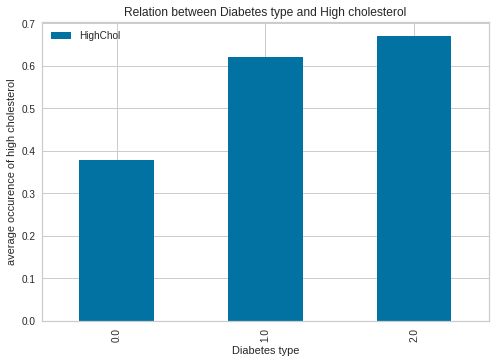

In [19]:
grouped_Cholesterol=df.groupby('Diabetes_012')[['HighChol']].mean()
grouped_Cholesterol.plot(kind='bar', title='Relation between Diabetes type and High cholesterol', ylabel='average occurence of high cholesterol',
         xlabel='Diabetes type')

In [20]:
from sklearn.model_selection import train_test_split

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


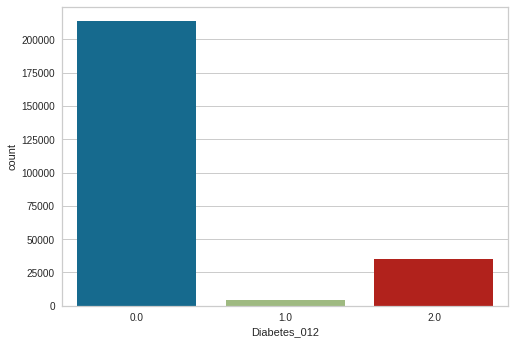

In [21]:
#distribution of target variable
sns.countplot(df['Diabetes_012'])

In [23]:
df['mean BMI'] = df.groupby('Diabetes_012')['BMI'].transform(np.mean)

In [24]:
df['mean Education'] = df.groupby('Diabetes_012')['Education'].transform(np.mean)
df['mean Income'] = df.groupby('Diabetes_012')['Income'].transform(np.mean)
Obese_binary=[]
for values in df['BMI']:
    if values > 30:
        Obese_binary.append(1)
    else:
        Obese_binary.append(0)
Obese_binary
df['obese']=Obese_binary
df

,Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,mean BMI,mean Education,mean Income,obese
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0,27.742521,5.106629,6.208663,1
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0,27.742521,5.106629,6.208663,0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0,27.742521,5.106629,6.208663,0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0,27.742521,5.106629,6.208663,0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0,27.742521,5.106629,6.208663,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
253675,0.0,1.0,1.0,1.0,45.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,3.0,0.0,5.0,0.0,1.0,5.0,6.0,7.0,27.742521,5.106629,6.208663,1
253676,2.0,1.0,1.0,1.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,4.0,0.0,0.0,1.0,0.0,11.0,2.0,4.0,31.944011,4.745516,5.210094,0
253677,0.0,0.0,0.0,1.0,28.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,5.0,2.0,27.742521,5.106629,6.208663,0
253678,0.0,1.0,0.0,1.0,23.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0,1.0,7.0,5.0,1.0,27.742521,5.106629,6.208663,0


In [92]:
y_data=df['Diabetes_012']
#Droped Gen Hlth, PhysHlth, MentHlth since they were subjective scores and  means since they will make artifically boost predictive confidence
x_data=df.drop(columns=['Diabetes_012', 'GenHlth','obese','PhysHlth', 'MentHlth','mean BMI', 'mean Education', 'mean Income'])
x_data1=x_data[['HighBP','HighChol']]

In [93]:
x_data1

,HighBP,HighChol
0,1.0,1.0
1,0.0,0.0
2,1.0,1.0
3,1.0,0.0
4,1.0,1.0
...,...,...
253675,1.0,1.0
253676,1.0,1.0
253677,0.0,0.0
253678,1.0,0.0


In [94]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x_data=scaler.fit_transform(x_data)
#split into train and test data
x_train, x_test, y_train, y_test=train_test_split(x_data,y_data, test_size=0.10)

In [95]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import plot_confusion_matrix
DTC = DecisionTreeClassifier()

In [96]:
DTC.fit(x_train,y_train)
test= DTC.predict(x_test)
print(accuracy_score(y_test, test))
print(classification_report(y_test, test))
print(confusion_matrix(y_test, test))

0.7811415957111322
              precision    recall  f1-score   support

         0.0       0.87      0.88      0.88     21424
         1.0       0.02      0.02      0.02       457
         2.0       0.29      0.28      0.29      3487

    accuracy                           0.78     25368
   macro avg       0.40      0.39      0.39     25368
weighted avg       0.78      0.78      0.78     25368

[[18838   370  2216]
 [  338    11   108]
 [ 2385   135   967]]


In [97]:
from sklearn.metrics import explained_variance_score
from sklearn.metrics import max_error
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
LR= LinearRegression()
LR.fit(x_train,y_train)
LRtest= LR.predict(x_test)
print(LR.score(x_test, y_test))


0.15346014611882208


In [98]:
lsx=[]
i=.20
lsy=[]
while i<=.9:
    x_train, x_test, y_train, y_test=train_test_split(x_data,y_data, test_size=i)
    DTC.fit(x_train,y_train)
    test= DTC.predict(x_test)
    lsy.append(accuracy_score(y_test, test))
    lsx.append(i)
    i=i+.1
print(lsx)
print(lsy)   

[0.2, 0.30000000000000004, 0.4, 0.5, 0.6, 0.7, 0.7999999999999999, 0.8999999999999999]
[0.7796436455376853, 0.7748242559621575, 0.7728043204036582, 0.7741248817407758, 0.7709121728161463, 0.7695972428706582, 0.7649006622516556, 0.761961701531238]


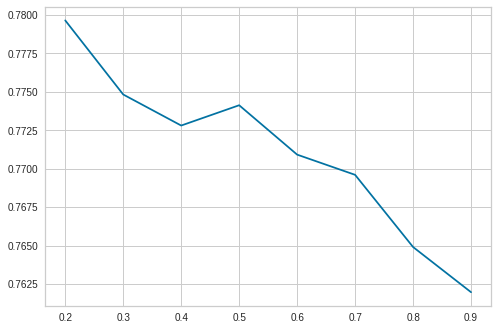

In [99]:
plt.plot(lsx, lsy)
xlabel=('ratio of test sample')
ylabel=('accuracy scores')
plt.show()


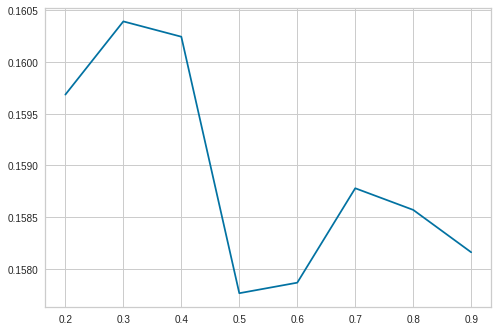

In [100]:
lsx=[]
i=.20
lsy=[]
while i<=.9:
    x_train, x_test, y_train, y_test=train_test_split(x_data,y_data, test_size=i)
    lsy.append(LR.score(x_test, y_test))
    lsx.append(i)
    i=i+.1
plt.plot(lsx, lsy)

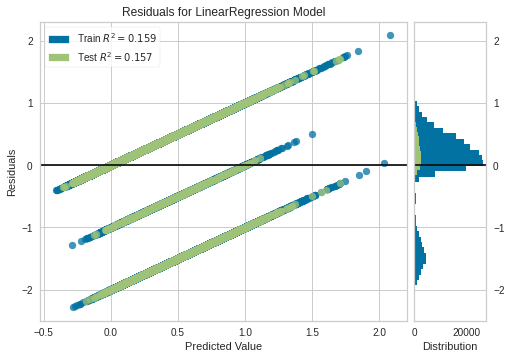

In [101]:
try:
    from sklearn.utils import safe_indexing
except ImportError:
    from sklearn.utils import _safe_indexing
from yellowbrick.regressor import ResidualsPlot
x_train, x_test, y_train, y_test=train_test_split(x_data,y_data, test_size=0.10)
LR= LinearRegression()
reg= LR.fit(x_train,y_train)
LRtest= LR.predict(x_test)
visual=ResidualsPlot(reg)
visual.fit(x_train,y_train)
visual.score(x_test,y_test)
visual.poof()


[Text(0.5, 0.8333333333333334, 'HighBP <= 0.5\ngini = 0.271\nsamples = 228312\nvalue = [192334, 4155, 31823]'),
 Text(0.25, 0.5, 'HighChol <= 0.5\ngini = 0.136\nsamples = 130235\nvalue = [120820, 1549, 7866]'),
 Text(0.125, 0.16666666666666666, 'gini = 0.096\nsamples = 91610\nvalue = [87003, 768, 3839]'),
 Text(0.375, 0.16666666666666666, 'gini = 0.222\nsamples = 38625\nvalue = [33817, 781, 4027]'),
 Text(0.75, 0.5, 'HighChol <= 0.5\ngini = 0.408\nsamples = 98077\nvalue = [71514, 2606, 23957]'),
 Text(0.625, 0.16666666666666666, 'gini = 0.311\nsamples = 39760\nvalue = [32312, 797, 6651]'),
 Text(0.875, 0.16666666666666666, 'gini = 0.459\nsamples = 58317\nvalue = [39202, 1809, 17306]')]

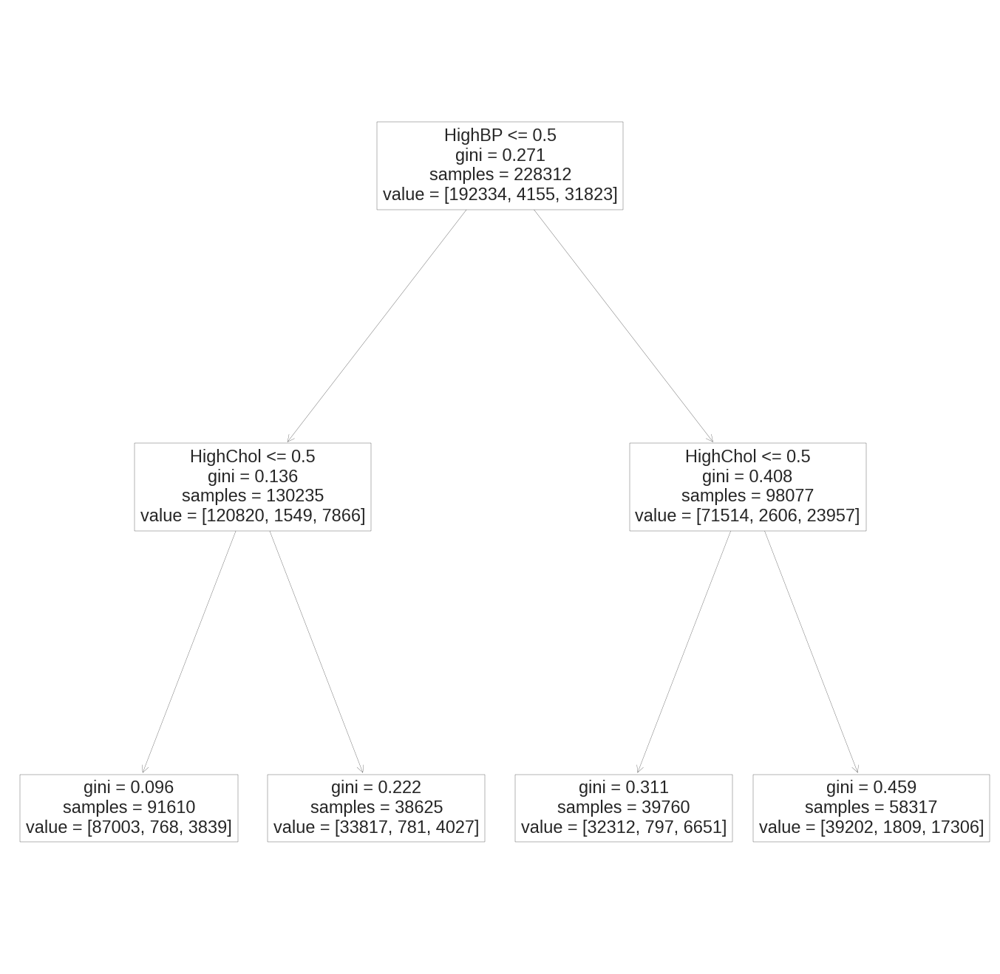

In [102]:
from sklearn.tree import plot_tree
from sklearn import tree
x_train1, x_test1, y_train1, y_test1=train_test_split(x_data1,y_data, test_size=0.10)
model=DTC.fit(x_train1,y_train1)
plt.figure(figsize=(24,24))
plot_tree(model, feature_names= x_data1.columns)



In [103]:
plt.show()
import graphviz
dot_data = tree.export_graphviz(model, out_file=None, 
                                feature_names=x_data1.columns)


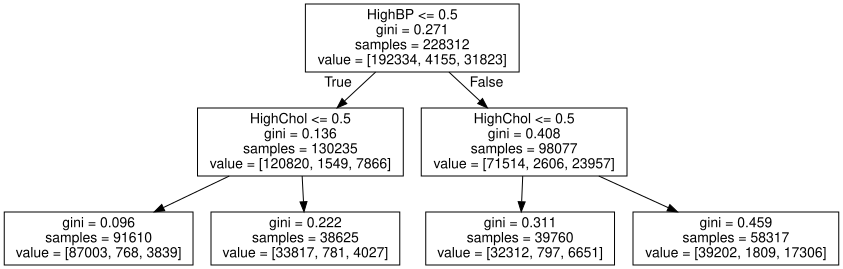

In [104]:
graph = graphviz.Source(dot_data, format="png") 
graph




ModuleNotFoundError: ignored